<a id='000-2'></a>
# Anonymity for Mobile Datasets

<a id='000-1'></a>
## Introduction

&emsp;In this project we looked at the [Geolife data](https://www.microsoft.com/en-us/research/project/geolife-building-social-networks-using-human-location-history/?from=http%3A%2F%2Fresearch.microsoft.com%2Fen-us%2Fprojects%2Fgeolife%2Fdefault.aspx#!downloads). This trajectory dataset constitutes 182 users who have been tracked regularly on a 4 year period. The data from one individual is split into many trajectories, or a paths, which are located in subfiles from the individual's folder. While working on the project, we focused on two principles:
1. Differential Privacy - mathematical noise added to some individuals' usage pattern to obscure personal data. In other word, a way to keep privacy of an individual within the data set, but keep the data public.

2. K anonymity - A way to make sure privacy is well kept within a dataset. It shows whether or not the information for each person contained in the release cannot be distinguished from at least x individuals - 1 whose information also appear in the release.


&emsp; After using pandas with a few other libraries to load the data, we then maped the points using Ipyleaflet and folium, but mapping millions of points on Ipyleaflet proposed two problems: run time and laggy map. Forunatley, we came across the datashader library which with geoviews, holoview, and bokeh allowed us to plot millions of points in a matter of seconds. While we  could have also used ipyleaflet and folium to create different functions to draw a heatmap, or the individuals' trajectories, we used datashader, geoviews, holoviews and bokeh to plot all the data points from the 182 individuals. Thenafter, we used numpy to apply the concepts of k-anonymity and differential privacy on our data (more on that later). Matplotlib also came in helpful to plot interesting graphs using data on k-anonimity and influence (again more on that later).

<br>


**Hyperlink to naviguate through our jupyter notebook:**
# [Anonymity for Mobile Datasets](#000-2)
## &emsp;[Introduction](#000-1)
## &emsp;[Packages](#000)
### &emsp;&emsp;[1. Pandas](#001)
### &emsp;&emsp;[2. Ipyleaflet and Folium](#002)
### &emsp;&emsp;[3. Numpy](#003)
### &emsp;&emsp;[4. Datashader, Geoviews, Holoviews and Bokeh](#004)
### &emsp;&emsp;[5. Matplotlib](#005)
## &emsp;[K-Hotspots](#006)
### &emsp;&emsp;[Loading the data](#007)
### &emsp;&emsp;[Graphing the data](#008)
### &emsp;&emsp;[Discretizing the space](#009)
### &emsp;&emsp;[The K-Hotspot Function](#010)
### &emsp;&emsp;[Graphing the k-hotspots](#011)
## &emsp;[Influence Analysis](#012)
### &emsp;&emsp;[Hamming Distance and Influence](#013)
### &emsp;&emsp;[Graphing the Influence vs. K](#014)
## &emsp;[Differential Privacy](#015)
### &emsp;&emsp;[Loading the data and running the random function](#016)


<a id='000'></a>

## Packages
The main Libraries we used on our project and on the notebook are: *pandas*, *datashader*, *geoviews*, *holoviews*, *numpy* and *matplotlib*. However, we also used smaller libraries like *ipyleaflet*, *csv*, *os*, *bokeh*, *math* and *IPython*.

**To install all the libraries**:
*   ipyleaflet - *pip install ipyleaflet*
*   folium - *pip install folium*
*   geoviews - *pip install geoviews*
*   datashader - *pip install datashader*
*   pandas - *pip install pandas*
*   numpy - *pip install numpy*
*   holoviews - *pip install holoviews*
*   matplotlib - *pip install matplotlib*
*   bokeh - *pip install bokeh*
*   IPython - *pip install IPython*

<a id='001'></a>
### &emsp;1. Pandas
  Pandas is a fast and powerful library used for data manipulation and analysis. It provides data structures and operations to manipulate dataframes. 
  We used Pandas to transfer the trajectrories (the path) from each individual, which were located in PLT(similar to CSV) files, into multiple dataframes revealing the time, the date, the longitude, latitude (etc) of the invidiual every time their position was taken.
  
<br>

Pandas commands we used:
* *import pandas as pd* - This was used in order to import pandas in our code
* *pd.DataFrame({})* - We used this to create a dataframe for the individuals coordinates
* *pd.concat(list_of_dataframes)* - We used this to combine certain dataframes together
* *dfName[column name]* - This was used in order to access a full column
* *dfName.loc[number]* - We used this to find the number of times the index of a row=number
* *dfName.index* - We used this to get a list of all the indices of the dataframe
* *df = df[df['X'] < bound]* - This commands removes all the rows within df where 'X' is more than 'bound' and updates df. Notice that the '<' can be changed to '>' 

<h4><center>Example of pandas comand we used:</center></h4>

In [273]:
# This was used in order to import pandas in our notebook
import pandas as pd

In [283]:
#We use the following format to create 2 data frames with x and y columns
df1 = pd.DataFrame({
    'x': [1,2,3,4,5],
    'y': [4,3,2,1,0]
})
df2 = pd.DataFrame({
    'x':[4,3,2,1,0],
    'y':[1,2,3,4,5]
})
#printing the first dataframe
df1

,x,y
0,1,4
1,2,3
2,3,2
3,4,1
4,5,0


In [287]:
#To access the 'x' column within the df1 dataframe
df1['x']

0    1
1    2
2    3
3    4
4    5
Name: x, dtype: int64


In [288]:
#In the following command we retrieve the 'x' and the 'y' at index=1. We could change this 1 to any other number 
df1.loc[1]

x    2
y    3
Name: 1, dtype: int64

In [280]:
#We can combine the dataframes df1 and df2(in df3) by using the following comand: 
df3 = pd.concat([df1,df2])
#printing df3
df3

,x,y
0,0,4
1,1,3
2,2,2
3,3,1
4,4,0
0,4,0
1,3,1
2,2,2
3,1,3
4,0,4


In [289]:
#When combining the dataframes into one, we forget to reset the index to 0-9. The following command could be useful in this case
#as it prints back the list of the indices
df3.index

Int64Index([0, 1, 2, 3, 4, 0, 1, 2, 3, 4], dtype='int64')

In [291]:
#The next code removes all the rows where 'x'>=3 from df3. We could change 'x' to 'y' and the 3 to any other number.
df3[df3['x']<3]

,x,y
0,0,4
1,1,3
2,2,2
2,2,2
3,1,3
4,0,4


<a id='002'></a>
### &emsp;2. Ipyleaflet and Folium
Ipyleaflet is an interactive library that uses ipywidgets. The library gave us the opportunity to create interactive maps and draw paths, points and even a heatmap. The downside of this library is that it struggles to plot more than 10,000 points thus, we decided to use datashader, holoviews and geoviews than can manage up to billions of points. We additionally used *folium* in order to load maps on the google colab. The folium function are written down and finish all with `WithFolium`. Both of the lirbaries work with the [latitude, longitude] coordinate system.

Importing the library in the notebook:
 - *from ipyleaflet import* * 
 - *import folium*
 - *from folium.plugins import HeatMap*

Ipyealflet Commands we used:
 - *map = Map(center=(lat, lon), zoom =5)* - This command creates a map centered at lat, lon.
 - *lines = Polyline(locations = locations,  color = "black", fill = False)* - This will create a line which goes through each coordinate from the "locations" list. The lines will be created in black. If a list of list of coordinates is given it will create a different line for each list within the list "locations".
 - *heatmap = Heatmap(locations=heat_data, radius=20 )* - This command allowed us to create a heatmap, taking a list of coordinates (lat, lon) as input. The more the radius is increased, the more blurred the heatmap will be. 
 - *map.add_layer(object)* - When we have create the points, the heatmap or the lines, we need do draw them on the map. To do so, we will add a layer and the object will be what you want to draw(points, lines, heatmap, etc..)

Folium Commands we used:
 - *m = folium.Map(location=(lat, lon), starting_zoom =5)* - This command creates a map centered at lat, lon.
 - *folium.PolyLine(locations,color="black").add_to(m)* - This will create a line which goes through each coordinate from the "locations" list. The lines will be created in black. If a list of list of coordinates is given it will create a different line for each list within the list "locations".
 - *Heatmap(locations=heat_data, blur=35).add_to(m)* - This command allowed us to create a heatmap, taking a list of coordinates (lat, lon) as input. We pass in 35 to blur the heatmap so that we cacn analyze it more easily.

In [1]:
#importing folium and ipyleaflet
from ipyleaflet import *
import folium
#importing folium heatmap
from folium.plugins import HeatMap
#importing random as we need it later in our code to create a heatmap
import random

In [2]:
#creating a map with ipyleafet
m1 = Map(center = (0,0), zoom=5)
#creating a map with folium
m2 = folium.Map(location = (0,0))

In [3]:
#Here we show the ipyleaflet map, my just writing 'm1', but you could write 'm2' and show the folium map
m1

Map(center=[0, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text'…

In [4]:
#creating a black line which goes from [0,0]->[1,1]->[0,2] and adding it to the ipyleaflet map
line = Polyline(locations = [[0,0],[1,1],[0,2]], color = "black", fill = False)
m1.add_layer(line)
#creating a black line which goes from [0,0]->[1,1]->[0,2] and adding it to the folium map
folium.PolyLine([[0,0],[1,1],[0,2]], color = 'black').add_to(m2)
#showing the ipyleaflet map, but again you can change this to the folium which outputs the same thing
m1

Map(center=[0, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text'…

In [5]:
#using random, we create a list of 1000 random locations which we will plot through a heatmap
locations  = [[random.uniform(-80, 80), random.uniform(-180, 180)]for i in range(10000)]
#creating an ipyleaflet heatmap using the locations and adding it to ipyleaflet map
heatmap = Heatmap(
            locations=locations,
            radius=20
        )
m1.add_layer(heatmap)
#creating a folium heatmap using the locations and adding it to the folium map
HeatMap(locations, blur = 35).add_to(m2)
#showing the folium map, but you could change this to the ipyleaflet map
m2

<a id='003'></a>
### &emsp;3. Numpy
Numpy is a very powerfull python libraries that provides structural support for large, multi-dimensional arrays and matrices as well as complex math operations to opperate on these arrays and matrices. We used numpy to create huge 2-D arrays when we discretized the space around the Beijing area, more on that later.

**Numpy commands we used**:
* *import numpy as np* - In order to import the numpy lirbary in our jupyter notebook
*  *np.zeros((n, m), dtype=int)* - We used this to create a 2-D numpy matrix which has 'n' rows and 'm' columns and only accepted integers values.
* *np.nonzero(2D_mat)* - This command took the 2D-matrix we had create and returned 2 arrays, one with all the i-indices where the matrix had an element not equal to 1 and the other with all the j-indices where the matrix had an elemt not equal to 1. We could then combine the two arrays and create a list with all the (i,j) where mat[i][j]!=0
* *np.log(n)* - To take $ln(n)$
* *np.exp(n)* - To put $e^n$
* *np.polyfit(x, y, 1)* - This is the equivalent of doing a linear regression using a list of Xs and Ys. The last input, 1, is there to precise that the fit is for a polynomial of degree 1
* *np.linspace(lower, higher, 10)* - We used this in order to create 10 numbers equally distanced starting at lower and ending at upper
* *np.corrcoef(x, y)[0,1]* - This function first runs a linear regression on the data points and then a R^2 test. The full command returns R which then needs to be squared.

In [8]:
#importing numpy 
import numpy as np
#importing random for later
import random

In [337]:
#we create a 5 by 5 np matrix full of zeros using numpy
mat = np.zeros((5,5), dtype=int)
#printing the matrix
mat

array([[0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0]])

In [338]:
#We take 2 random 0s in the matrix and turns them into 1
mat[random.randrange(0,5)][random.randrange(0,5)]=1
mat[random.randrange(0,5)][random.randrange(0,5)]=1
#printing the updated matrix
mat

array([[0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0],
       [0, 1, 0, 0, 0],
       [0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0]])

In [344]:
#Using np, we are able to get all the indices where the matrix is not equal to 0 and we store them in indices. The output is a 
#tuple of list, where the first list is the lists of'i' while the second is the lists of 'j' where mat[i][j]!=0.
indices = np.nonzero(mat)
#Putting the indices in the format of a list of tuples where each tuples are (i,j)
l = list(zip(indices[0], indices[1]))
l

[(0, 4), (2, 1)]

In [352]:
#using np, we create a list of 9 numbers between 0 and 10
arr = np.linspace(0,10,10)
#printing the list
arr

array([ 0.        ,  1.11111111,  2.22222222,  3.33333333,  4.44444444,
        5.55555556,  6.66666667,  7.77777778,  8.88888889, 10.        ])

In [368]:
#Using numpy, we input x values(in this case:[0,1,2]) and y values(in this case:[1,3,5]) and the polynomial degree(here: 1)
#the function output an array with [m, b] of the equations y=mx+b
m,b = np.polyfit([0,1,2],[1,3,5], 1)
#printing the equation following the format y=mx+b
print("y = "+str(round(m,4))+"x + "+str(round(b,4)))

y = 2.0x + 1.0


In [9]:
#The following line uses numpy to create a best fit line and then run a R^2 test. The command returns R, we then square and 
#print it.
r = np.corrcoef([0,1,2], [1,3,5])[0,1]
#In this case R^2=1 because the input points are perfectly in line
print(r**2)

1.0


In [345]:
#putting e to the second power
np.exp(2)

7.38905609893065

In [346]:
#taking the natural log of 10
np.log(10)

2.302585092994046

<a id='004'></a>
### &emsp;4. Datashader, Geoviews, Holoviews and Bokeh

Datashader is a library used for visualizing large datasets and anylize them. Precisely, it aggregates into grids that can be viewed in images and makes the plotting proces much more efficient.  Combining the Geoviews, Holoviews, and bokeh libraries with datashader we were able to map the 24 million points on an interactive map in less than a second.

Import command we used:
* *import datashader as ds*
* *import geoviews as gv*
* *import holoviews as hv*
* *import datashader.transfer_functions as tf*
* *from holoviews.operation.datashader import datashade, dynspread*

Command we used:
1. Changing the coordinate system of the dataframe 'df' from longitude, latitude to the x,y coordinates that geoviews, holoviews and datashader use.
 * *arr = ds.utils.lnglat_to_meters(df['longitude'], df['latitude'])*- This command returns an arrays consisting of two subarrays, the first one(at index 0), being the new "X" coordinates and the second one(at index 1), the new "Y" coordinates. You then have to assign them to new columns of the dataframe by writing: *df["X"]=arr[0]* and *df["Y"]=arr[1]*.
2. Creating an interactive map with the libraries
 * *geomap = gv.tile_sources.OSM.opts(width=500, height=300)* - This command uses geoviews to create a tile map
 * *points = hv.Points(gv.Dataset(df, kdims = ['X', 'Y']))* - This command combined geoviews with holoviews to take all the points with 'X' and 'Y' coordinates which were inside the 'df' dataframe and create the points.
 * *agg = dynspread(datashade(points, color_key = fire, element_type= gv.Image, aggregator = ds.count()))* - This command used holoviews with datashader in order to create an interactive image which could then be supperposed with the geoviews map to create the final product
 * *agg* * *geomap* - This supperposed the aggregated points with the geoviews map and created the final product
3. Creating a plot of the Beijing area points
 * *cv = ds.Canvas(plot_width=600, plot_height=524,x_range=x_range,y_range=y_range)* - This datashader command was used in order to create canvas with width=600, heigh=524 and with data range of x_range and y_range
 * *agg = cv.points(dfBeijing, 'X', 'Y')* - This was another datashader command which used the canvas created previously and created the points (X,Y) from the dfBeijing dataframe.
 * *tf.set_background(tf.shade(agg, cmap=fire),"black")* - This command set the background of the canvas black and plots the points created previously following a certain colormap called fire.
 * In order to import the fire colormap, it is necessary to run this line:
    - *from colorcet import fire* 

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
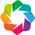

In [18]:
#With the following lines, we hope to import the necessary datashader, geoviews, holoviews and set the bokeh extensions
import datashader as ds
import geoviews as gv
import holoviews as hv
from datashader import transfer_functions as tf
from holoviews.operation.datashader import datashade, dynspread

hv.notebook_extension('bokeh')

#we also import pandas because we use later in the code 
import pandas as pd

#we also import the fire colormap as we use it when graphing our points
from colorcet import fire

In [73]:
#We will first be changing a dataset that uses longitude, latitudes to the x,y coordinates that geoviews, datashader and 
#holoviews are use
dataset = pd.DataFrame({
    'longitude': [random.uniform(116, 117) for i in range(100000)],
    'latitude': [random.uniform(39, 40) for i in range(100000)]
})
o = ds.utils.lnglat_to_meters(dataset['longitude'], dataset['latitude'])
dataset['X'] = o[0]
dataset['Y'] = o[1]
#printing the dataset table to se can see the changes that have been made
dataset

,longitude,latitude,X,Y
0,116.884922,39.817034,1.301157e+07,4.839390e+06
1,116.575319,39.643687,1.297711e+07,4.814298e+06
2,116.789522,39.711802,1.300095e+07,4.824150e+06
3,116.583395,39.702317,1.297800e+07,4.822778e+06
4,116.559955,39.116006,1.297539e+07,4.738302e+06
...,...,...,...,...
99995,116.932180,39.918092,1.301683e+07,4.854047e+06
99996,116.267968,39.766800,1.294289e+07,4.832112e+06
99997,116.363043,39.044766,1.295347e+07,4.728086e+06
99998,116.844306,39.563835,1.300705e+07,4.802761e+06


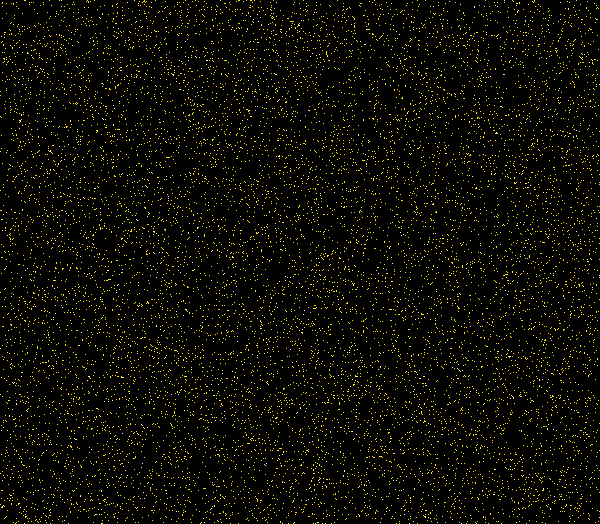

In [74]:
#Now we will be ploting the point on a static black background. Because we got the points using a random function the plot will 
#not have a particular pattern. However, when we plot the geolife data, the plot shows the paths of the individuals.
x_range = (12913060, 13024381)
y_range = (4721671, 4865943)
cv = ds.Canvas(plot_width=600, plot_height=524, x_range=x_range, y_range=y_range)
agg = cv.points(dataset, 'X', 'Y')
tf.set_background(tf.shade(agg, cmap=fire),"black")

In [78]:
#Now using the dataset we just created, we will plot them on an actual map using the commands mentioned above.
geomap = gv.tile_sources.OSM.opts(width=750, height=500)
points = hv.Points(gv.Dataset(dataset, kdims = ['X', 'Y']))
agg = dynspread(datashade(points, color_key = fire, element_type= gv.Image, aggregator = ds.count()))
#Finally, to show the map:
geomap*agg

:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [X,Y]   (R,G,B,A)

<a id='005'></a>
### &emsp;5. Matplotlib
Matplotlib is python library used for data visualization and graphics. Throughout our project, we used the pyplot to plot scatter plots, best fits and more. 

**Command we used**:
* *from matplotlib import pyplot as plt* - We used this in order to import pyplot in our notebook
* *plt.figure()* - This was used to create an empty pyplot graph
* *plt.scatter(x, y)* - We used this command to add to the plt.figure a scatter plot with coordinates (x,y)
* *plt.plot(x, y, label = label)* - This links the points in the lists x,y together and plots them on plt.figure
* *plt.title("y vs. x")* - This adds a title to the graph called 'y vs. x'
* *plt.xlabel('x')* - This adds an x-axis label called 'x'
* *plt.ylabel('y')* - This adds an y-axis label called 'y'
* *plt.legend()* - This allows the legend to show
* *plt.show()* - This prints the graph so that we can see it

In [83]:
#importing the matplotlib plotting library on the notebook
import matplotlib.pyplot as plt

#we also import numpy to do a regression
import numpy as np

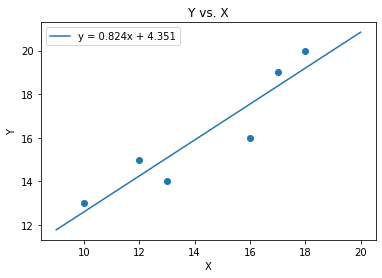

In [88]:
#Creating the x,y list, which we will plot and run a best fit.
x = [10,12,13,16,17,18]
y = [13,15,14,16,19,20]
#Using a numpy function we introduced earlier, we run a linear regression on the data we just created. More on it during 
#the numpy section
m,b = np.polyfit(x,y, 1)
#Next, we create a string called label which has the equation we just created in the form of y=mx+b
label = "y = "+str(round(m,3))+"x + "+ str(round(b,3))
#We once again use numpy to create a few x points which we use for the line graph
x_line = np.linspace(9,20,10)
#Using the x points we just created, we create a list of y points which would lie on the line create by the regression
y_line = m*x_line+b
#Here, we are going to create a graph using matplotlib with the x,y list we used. 
plt.figure()
plt.scatter(x, y)
plt.plot(x_line,y_line,label=label)
plt.title("Y vs. X")
plt.xlabel("X")
plt.ylabel("Y")
plt.legend()
plt.show()

<a id='006'></a>
## K-Hotspots
<a id='007'></a>
### &emsp;Loading the data

Now, you should download the [Geolife data](https://www.microsoft.com/en-us/research/project/geolife-building-social-networks-using-human-location-history/?from=http%3A%2F%2Fresearch.microsoft.com%2Fen-us%2Fprojects%2Fgeolife%2Fdefault.aspx#!downloads). Once you have download it, you will use pandas coupled with a few other libraries to download the data into this notebook. We will use *pandas* dataframes to store the data and the libraries *csv* and *os* to go through the directories of the geolife folder.

 We import pandas with csv and os because they will be useful to retrieve the data. We import clear_output in order to give real time updates of the process. 

In [1]:
import pandas as pd
import csv
import os
from IPython.display import clear_output

We also import boto and boto3 because they were used when we used the AWS SageMaker and the s3 to load the geolife data in. Then we run the line `s3 = boto3.resource('s3')` to create an s3 variable which we use to load the data on AWS.

In [ ]:
import boto
import boto3
s3 = boto3.resource('s3')

The `getDataFrameFromFile(directory)` function returns a pandas dataframe of one of the trajectory, or path, file with directory (in other words: this will return the trajectory file of one individual, who will be chosen through the parameter direrctory). It should be noted that one individual may have more than one directory.

In [3]:
def getDataFrameFromFile(directory):
    # opening the file using csv
    with open(directory) as csv_file:
        csv_reader = csv.reader(csv_file, delimiter = ',')
        longitude = []
        latitude = []
        date = []
        time = []
        ticks = []
        counter = 0
        for row in csv_reader:
            if(counter>5):
                latitude.append(round(float(row[0]),5))
                longitude.append(round(float(row[1]),5))
                time.append(row[6])
                date.append(row[5])
                ticks.append(row[4])
            counter+=1;
        #creating a dataframe with the latitude, longitude, date, time and computer time of each and single point recorded 
        df = pd.DataFrame({
            'Latitude': latitude,
            'Longitude': longitude,
            'Date': date,
            'Time': time,
            'Ticks': ticks

        })
        return df

The `filesNames(directory)` function uses the *os* library to return a list of all the files within a folder with directory = directory.

###### Note: 
    os is used below in order to "walk" through the directory and get a list of the files present within the directory

In [4]:
def fileNames(directory):
    count = 0
    for files in os.walk(directory): 
        count = 0
        for file in files:
            if count>1:
                return file
            count+=1
            

The `getFinalDFfromIndividual` uses the two previous functions to return a dataframe for one individual given by the individual number(individual ∊ [0,181]). For example, if it is given the number 2, it will return the dataframe for the individual 002 within the geolife dataset.
    <br>
    
``dataFramesForIndividual`` first creates a list with one dataframe per trajectory. Because there are multiple trajectories per individuals, we concat to create one dataframe for the individual. However, when we concatonate the dataframes, we don't reset the indices. This will prove useful later when we want to graph certain trajectories of a certain individual.

   
$\color{red}{\text{WARNING:}}$
<br>

The directory used in the function below is mine and will need to be changed to your geolife folder name. Your directory should be something along the lines of "C://Users//...//Geolife Trajectories 1.3//Data//". The ending of the directory string should be left intact, except if you change it within your files.


In [5]:
def getFinalDFfromIndividual(individual):
    directory = "C://Users//thesm//Dropbox//Differential Privacy Project//Geolife Trajectories 1.3//Data//"+individual+"//Trajectory"
    allPaths = fileNames(directory)
    dataFramesForIndividual = []
    for file in allPaths:
        file_directory = directory+"//"+file
        dataFramesForIndividual.append(getDataFrameFromFile(file_directory))
    return pd.concat(dataFramesForIndividual)    

The `getDataFrameFromFile`, `fileNames` and `getFinalDFfromIndividual` functions above work together in the function below, `getListOfDataFrames` to create a list of 182 dataframes, each for one individual.

In [6]:
def getListOfDataFrames():
    individual = "000"
    allDF = []
    for i in range(0,182):
        if(i<10):
            individual="00"
            individual+=str(i)
        elif(i<100):
            individual = "0"
            individual+=str(i)
        else:
            individual=str(i)
        #the if and else statements were there to change the label number of each individual into 3 digits strings(ie. 12->"012", 0->"000",123->"123")
        allDF.append(getFinalDFfromIndividual(individual))
        #the next two lines is to give a real time update as where you are in the process. In this case, it will be shown as a percentage of the dataframes loaded
        clear_output(wait=True)
        print(round((i/182)*100,1),"%",flush=True)
    clear_output()
    return allDF 

While the previous function worked together using pandas, os, csv and more libraries to upload the local geolife data from you  computer, the next functions wre used for the Amazon Web Servers when we wanted to download the data from the s3 buckets. The next function is able to get all the names in a bucket with name `bucketName` and it returns all the directories as a list of list. Boto3 is used with s3 which was created earlier in the code.

In [7]:
def getDirectories(bucketName):
    directories = []
    tdirectories = []
    last = "000"
    for obj in s3.Bucket(name=bucketName).objects.all():
        s = os.path.join(obj.bucket_name, obj.key)
        if (s[-1]+s[-2]+s[-3])=="tlp":
            tdirectories.append(s)
        if (s[42]+s[43]+s[44])!=last:
            directories.append(tdirectories)
            tdirectories = []
        last = s[42]+s[43]+s[44]
    #Each individual has a list of directories of their location files within the AWS s3
    return directories

Given a directory, the folowing function `getDataFrameFromDirectory()` will load the geolife data from the file onto a pandas dataframe.

In [8]:
def getDataFrameFromDirectory(directory):
    dire = "s3://"+ directory 
    df = pd.read_csv(dire, names = ['Latitude','Longitude','Trash', 'Altitude','Date','Time','Ticks'])
    df.drop(columns=['Trash', 'Altitude'], inplace=True)
    df.drop([0,1,2,3,4,5], inplace=True)
    return df

This function combines the two previous function to create, like the function which used pandas, csv, os, a list of the individuals' dataframes.

$\color{red}{\text{WARNING:}}$
<br>
I named my bukcet geolifedata, but if you named it differently, replace geolifedata by the bucketname.

In [ ]:
def getListOfDataFramesWithAWS():
    directories = getDirectories("geolifedata")
    allDF = []
    print("0.0%")
    counter = 1
    for i in directories:
        tDFlist = []
        for j in i: 
            tempdf = getDataFrameFromDirectory(j)
            tDFlist.append(tempdf)
        allDF.append(pd.concat(tDFlist))
        clear_output(wait=True)
        print(round((counter/182)*100,1),"%",flush=True)
        counter+=1
    clear_output()
    return allDF

In [ ]:
#We use the functions above to store the list of dataframes in allDF if the data was stored in the s3 machines of the AWS
allDF = getListOfDataFramesWithAWS()

In [9]:
#We use the functions above to store the list of dataframes in allDF if the data was locally stored on the computer
allDF = getListOfDataFrames()

In [10]:
#we import datashader because the next function will use it
import datashader as ds

The next function takes the list of dataframes created by the `getListOfDataFrames` function as an input and converts the 'Longitude' and "Latitude" columns into 'X' and 'Y' collumns and add them to the dataframe. This function uses pandas and datashaders.

In [11]:
def addXYcolumns(allDF, changeLat):
    for i in allDF:
        if changeLat:
            i['Latitude'] = i['Latitude'].astype("float64")
        o = ds.utils.lnglat_to_meters(i['Longitude'], i['Latitude'])
        i['X'] = o[0]
        i['Y'] = o[1]

In [12]:
#We use the function above to add to each of the dataframes the 'X' and 'Y' rows
addXYcolumns(allDF, False)
#We also concat the list of dataframe into one dataframe, df. We will use df to graph all the points of the dataset and more.
df = pd.concat(allDF)

In [11]:
#To pick one individual and print his dataframe, write "allDF[individual number]". For example, we print the dataframe of 
#individual 153.
allDF[153]

,Latitude,Longitude,Date,Time,Ticks,X,Y
0,39.96705,116.34525,2007-07-21,05:07:08,39284.213287037,1.295149e+07,4.861155e+06
1,39.96723,116.34530,2007-07-21,05:08:52,39284.2144907407,1.295150e+07,4.861181e+06
2,39.96750,116.34530,2007-07-21,05:09:18,39284.2147916667,1.295150e+07,4.861221e+06
3,39.96777,116.34532,2007-07-21,05:09:48,39284.2151388889,1.295150e+07,4.861260e+06
4,39.96797,116.34532,2007-07-21,05:10:05,39284.2153356481,1.295150e+07,4.861289e+06
...,...,...,...,...,...,...,...
852,39.99303,116.46198,2012-06-17,16:51:00,41077.7020833333,1.296449e+07,4.864929e+06
853,39.99292,116.46185,2012-06-17,16:51:01,41077.7020949074,1.296447e+07,4.864913e+06
854,39.99285,116.46185,2012-06-17,16:51:02,41077.7021064815,1.296447e+07,4.864903e+06
855,39.99286,116.46194,2012-06-17,16:51:04,41077.7021296296,1.296448e+07,4.864905e+06


In [12]:
#We print the df dataframe
df

,Latitude,Longitude,Date,Time,Ticks,X,Y
0,39.98470,116.31842,2008-10-23,02:53:04,39744.1201851852,1.294851e+07,4.863719e+06
1,39.98468,116.31845,2008-10-23,02:53:10,39744.1202546296,1.294851e+07,4.863716e+06
2,39.98469,116.31842,2008-10-23,02:53:15,39744.1203125,1.294851e+07,4.863718e+06
3,39.98469,116.31839,2008-10-23,02:53:20,39744.1203703704,1.294850e+07,4.863718e+06
4,39.98465,116.31826,2008-10-23,02:53:25,39744.1204282407,1.294849e+07,4.863712e+06
...,...,...,...,...,...,...,...
17,40.91487,111.71050,2008-03-14,03:39:56,39521.1527314815,1.243556e+07,4.999793e+06
18,40.91427,111.71033,2008-03-14,03:41:17,39521.1536689815,1.243554e+07,4.999705e+06
19,40.91247,111.71067,2008-03-14,03:43:02,39521.1548842593,1.243557e+07,4.999440e+06
20,40.91152,111.71132,2008-03-14,03:43:28,39521.1551851852,1.243565e+07,4.999300e+06


<a id='008'></a>
### Graphing the data
Before we start maniupalating the data, we will graph the load data. First, using datashader, geoviews, holoviews and bokeh, we will graph all the data points, then using ipyleaflet or folium, we will graph some of the individuals on a heatmap. Finally, we will graph, on a black canvas, all the data within the Beijing area. 

In [26]:
#We start by importing datashader, geoviews, holoviews
import datashader as ds
import geoviews as gv
import holoviews as hv
from colorcet import fire
from holoviews.operation.datashader import datashade, dynspread
import datashader.transfer_functions as tf
#Then we import folium and ipyleaflet
from ipyleaflet import * 
import folium
from folium.plugins import HeatMap

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
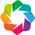

In [27]:
#We set up the bokeh extension for graphing with datashader, goeviews and holoviews.
hv.notebook_extension('bokeh')

Like I said in the quick introduction paragraph, we will start by graphing the data using *datashader*, *goeviews*, *holoviews* and *bokeh*. The next funcion takes a dataframe as input and return a map with all the points of the dataframe ploted. We are using *datashader*, *holoviews*, *geoviews* and *bokeh* because *ipyleaflet* and *folium* could not handle more than 10,000 points, while the other 4 can handle up to a few billion points.

In [28]:
def drawDataFrame(df, w, h):
    geomap = gv.tile_sources.OSM.opts(width=w, height=h)
    points = hv.Points(gv.Dataset(df, kdims = ['X', 'Y']))
    agg = dynspread(datashade(points, color_key = fire, element_type= gv.Image, aggregator = ds.count()))
    return geomap*agg

In [17]:
#We draw the whole data set using the above function and inputing the dataframe df which has all the data.
drawDataFrame(df, 800, 600)

:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [X,Y]   (R,G,B,A)

The next folowing functions will work together to allow us to draw an indivdiual's paths or certain of his trajectrories. We use ipyleaflet or folium. The next function returns the number of trajectories of an individual. We use it when we want to determine which trajectory of an individual we want to graph.

In [18]:
def numberOfTrajectories(individual):
    return len(allDF[individual].loc[0])

The first function `rgb2hex` takes for input a color of the form (RGB) and changes it to a HTML format. It is needed because ipyleaflet uses color of format HTML and the second function, `getColor` uses it in order to change the RGB color output to an HTML color output. The color created changes for every individual thus allowing us to identify the person by looking at their paths.

In [19]:
def rgb2hex(r,g,b):
    return "#{:02x}{:02x}{:02x}".format(r,g,b)

def getColor(i):
    individual = "000"
    if(i<10):
        individual="00"
        individual+=str(i)
    elif(i<100):
        individual = "0"
        individual+=str(i)
    else:
        individual=str(i)
    return rgb2hex(int(individual[0]) * 25, int(individual[1]) * 25, int(individual[2]) * 25) 

The function below takes as input an individual and will draw them on the map using the dataframe, optionally, it can also take a list of trajectories(paths) or a trajectory from that user. The other input, m, is an ipyleaflet map.

In [20]:
def drawLine(individual, m, *trajectories):
    finalLocations = []
    tempLocations = []
    #in the case where an individual does want to draw specific trajectories 
    if trajectories:
        trajectories = trajectories[0]
        n = numberOfTrajectories(individual)
        counter = 0
        record = False
        if not trajectories or trajectories[-1]>n or trajectories[0]<1:
            print("Trajectory Input Is Incorrect")
            return -1
        for la, lo, i in zip(allDF[individual]['Latitude'], allDF[individual]['Longitude'], allDF[individual].index):
            if(i==0):
                counter+=1
                if not trajectories:
                    break
                if(counter == trajectories[0]):
                    trajectories.pop(0)
                    if tempLocations:
                        finalLocations.append(tempLocations)
                        tempLocations = []
                    record = True
                else:
                    record = False
            if record:
                tempLocations.append((la,lo))
        if tempLocations:
            finalLocations.append(tempLocations)
    #in the case an individual wants to draw all the trajectories of an individual 
    else:
        for la, lo, i in zip(allDF[individual]['Latitude'], allDF[individual]['Longitude'], allDF[individual].index):
            if(i==0):
                if tempLocations:
                    finalLocations.append(tempLocations)
                    tempLocations = []
            else:
                tempLocations.append((la,lo))
            
    lines = Polyline(locations = finalLocations,  color = getColor(individual), fill = False)            
    m.add_layer(lines)  

This function does the same thing as the previous one but with the Folium Library. We used this function for the google colab as it does not support ipyleaflet. The only difference is that m needs to be a folium map, not an ipyleaflet map.

In [21]:
def drawLineWithFolium(individual, m, *trajectories):
    tempLocations = []
    c = getColor(individual)
    if trajectories:
        trajectories = trajectories[0]
        n = numberOfTrajectories(individual)
        counter = 0
        record = False
        if not trajectories or trajectories[-1]>n or trajectories[0]<1:
            print("Trajectory Input Is Incorrect")
            return -1
        for la, lo, i in zip(allDF[individual]['Latitude'], allDF[individual]['Longitude'], allDF[individual].index):
            if i==0:
                counter+=1
                if not trajectories:
                    break
                if counter == trajectories[0]:
                    trajectories.pop(0)
                    if tempLocations:
                        folium.PolyLine(tempLocations,color=c).add_to(m)
                        tempLocations = []
                    record = True
                else:
                    record = False
            if record:
                tempLocations.append((la,lo))
    else:
        for la, lo, i in zip(allDF[individual]['Latitude'], allDF[individual]['Longitude'], allDF[individual].index):
            if i==0:
                if tempLocations:
                    folium.PolyLine(tempLocations,color=c).add_to(m)
                    tempLocations = []
            else:
                tempLocations.append((la,lo))
    if tempLocations:
        folium.PolyLine(tempLocations, color = c).add_to(m)
    

In [22]:
#This line creates an ipyleaflet map to draw the lines of an individual and, optionally, some of its trajectories
m2 = Map(center = (39,116), zoom = 5)
#prints the amount of trajectories of the individual 153
print(numberOfTrajectories(153))
#draws the 1st, 2nd, 3rd, 100th, 154th and 2023rd trajectories of individual 153 and all of the trajectories of individual 1
drawLine(153, m2, [1,2,3,100,154,2023])
#Drawing all the trajectories of individual 001
drawLine(1, m2)
#drawing the map with the lines from individual 1 and some from individual 153
m2

2024


Map(center=[39, 116], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_te…

The next functions use ipyleaflet or folium to create heatmaps from the data they are given. The next function will draw a heatmap for the whole dataset using ipyleaflet. allDF is the list of dataframes we created in the beginning and m is an ipyleaflet map.

In [13]:
def drawHeatMap(allDF, m):
    finalList = []
    heat_data = []
    for i in allDF:
        tempList = i[['Latitude','Longitude']].to_records(index=False).tolist()
        finalList+=tempList
        print((round((counter/182)*100,1)),"%",flush=True)
    clear_output()
    print("finishing...")
    n = len(finalList)
    for i in range(0,n,120):
        heat_data.append(finalList[i])
    heatmap = Heatmap(
            locations=heat_data,
            radius=20
    )
    m.add_layer(heatmap)
    clear_output()

This function does the same thing as the previous one but with the Folium Library. We used this function for the google colab as it does not support ipyleaflet. Once again, m should be a folium map rather than an ipyleaflet map.

In [14]:
def drawHeatMapWithFolium(allDF, m):
    finalList = []
    heat_data = []
    counter=0
    for i in allDF:
        counter+=1
        tempList = i[['Latitude','Longitude']].to_records(index=False).tolist()
        finalList+=tempList
        clear_output(wait=True)
        print((round((counter/182)*100,1)),"%",flush=True)
    clear_output()
    print("finishing...")
    n = len(finalList)
    for i in range(0,n,120):
        heat_data.append(finalList[i])
    HeatMap(heat_data, blur = 35).add_to(m)
    clear_output()

In [15]:
#Because we used ipyleaflet in our previous example, we use folium in this one. We creating a folium map.
m = folium.Map(location = (39,116), zoom_start=3)
#We draw the heatmap using folium
drawHeatMapWithFolium(allDF, m)
#to show the map:
m

###### Note: 
    This heatmap shows that a huge portion of the datapoints are in China and most importantly that an important portion is in Beijing. For the purpose of our study/project, we needed to focus on a smaller area. We decided to pick the Beijing area because it is small enough that we can do calculation with it and has enough datapoints.

Now that we have determined that most of the data is clustered in Beijing we will create a static graph of the Beijing area to understand how the data is clustered. The focusOnBeijing(df) function returns a dataframe where all 'X' and 'Y' coordinates are within the Beijing rectangle, should take around 6.5 minutes. It uses *pandas*.

In [21]:
def focusOnBeijing(df):
    dfBeijing = df[df['X'] < 13068908.2191]  
    dfBeijing = dfBeijing[dfBeijing['X'] > 12890797.0338]
    dfBeijing = dfBeijing[dfBeijing['Y'] < 4982886.3165]
    dfBeijing = dfBeijing[dfBeijing['Y'] > 4779131.1812]
    return dfBeijing

In [25]:
#creating the dfBeijing which removes all points not within the Beijing area
dfBeijing = focusOnBeijing(df)

Using the `focusOnBeijing` function, we created a dataframes of all the points within the Beijing area. The next function, `plotDFBeijingWithDS`, uses *datashader*, *holoviews*, *geoviews* and *bokeh* and the dataframe of the Beijing area to plot all the points within Beijing on a black background. 

In [34]:
def plotDFBeijingWithDS(dfBeijing,w, h):
    x_range = (12890797.0338, 13068908.0)
    y_range = (4779131.1812, 4982886.3165)
    cv = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    agg = cv.points(dfBeijing, 'X', 'Y')
    return tf.set_background(tf.shade(agg, cmap=fire),"black")

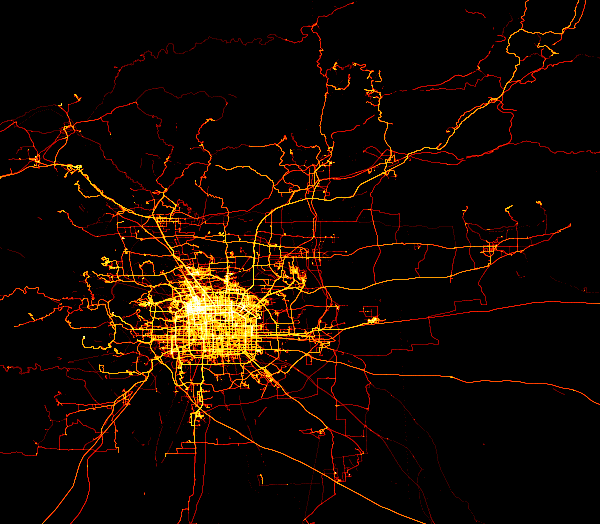

In [51]:
#plotting the Beijing df using the above function
plotDFBeijingWithDS(dfBeijing,600, 524)

<a id='009'></a>
### Discretizing the space

Throughout this section we will "discretize" the space and explain what we mean. First, we need to import the library numpy and the math module.

In [15]:
import numpy as np
import math

The next function will "discretize" the space. What we mean by discretzing the space is to transform a rectangle into a grid and store the grid under the form of a matrix. By taking the max_x, min_x, max_y, min_y coordinates it creates a grid with squares of dimensions divisor*divisor, and from there a matrix where each square of the grid is represented by a 0 in the numpy matrix. The function returns a list of the matrix + max_x, min_x, max_y, min_y and the divisor, which allow us to do more manipulation later with the matrix.

<h4><center>Example:</center></h4>

   In the example below, imagine max_x=110, min_x=50, max_y=90, min_y=50 and divisor=10. The function will divide the 40x60 meters rectangle into a grid of 10x10 meters squares and thus create a 4x6 matrix. Below is the rectangle that is divided.

![](img/MatrixDrawing.png)

The matrix created would look something like this:
$$\begin{bmatrix} 0 & 0 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \end{bmatrix}$$ 


In [16]:
def discretizeSpace(max_x, min_x, max_y, min_y, divisor):
    if type(max_x)!=int or type(max_y)!=int or type(min_y)!=int or type(min_x)!=int:
        print("Only take int")
        return -1
    if (max_x-min_x)%divisor!=0:
        max_x = max_x + divisor - (max_x-min_x)%divisor
    if (max_y-min_y)%divisor!=0:
        max_y = max_y + divisor - (max_y-min_y)%divisor
    xdiff = int((max_x-min_x)/divisor)
    ydiff = int((max_y - min_y)/divisor)
    return [[max_x, min_x, max_y, min_y, divisor], np.zeros((ydiff,xdiff), dtype=int)]

In [17]:
#In this box, we use the function above to create a 0-matrix around the Beijing area(shown by the graph in the previous section)
#and store it in the mat matrix. The matrix created is a 20376 x 17812 matrix full of 0s.
mat = discretizeSpace(13068908, 12890797, 4982886, 4779131, 10)

At first, the Matrix created with the other function contains just zeros. The `changeMatrix` function will take that matrix and add 1's where an individual has been. Continuing the example above, let's assume that our individual(input) has been at (60,70), (56,89) and (104, 65) and that our matrix input is:
<br>

$$\begin{bmatrix} 0 & 0 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \end{bmatrix}$$ 

Then after the function has ran, our map should look like this:


![](img/MatrixDrawing2.0.png)

Thus our output will be:
<br>

$$\begin{bmatrix} 1 & 0 & 0 & 0 & 0 & 0 \\ 0 & 1 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 1 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \end{bmatrix}$$ 


In [18]:
def changeMatrix(mat, individual):
    tempdf = allDF[individual]
    for x,y in zip(tempdf['X'], tempdf['Y']):
        if x<mat[0][0] and x>mat[0][1] and y< mat[0][2] and y>mat[0][3]:
            i = math.floor((x-mat[0][1])/mat[0][4])
            j = math.floor((mat[0][2]-y)/mat[0][4])
            mat[1][j][i] = 1
    return mat

When looking at our matrices, we put a *1* on a square where an individual has been. However, this can be a problem when an individual is on a side or corner of that square. Instead of just lighting up that square, we would rather have it light up the squares ajacent to it and that square.

<h4><center>Example:</center></h4>

!["Before"](img/MatrixDrawing1.11.png)

In the example we used, the individual was at (60,70), the blue point on the above drawing, and we light up the $\color{red}{\text{red}}$ square. However, the individual was also on the $\color{green}{\text{green}}$ squares. This is a problem that our next function `deDiscrete` addresses.

The function `deDiscrete` addresses that problem by lighting up- (turning a *0* to a *1*)- every squares around the already lighten up squares. Eventhough we lose precision, we end up creating better hotspots(we will talk about them later). Below, we continue to use the same example as we used with the `discretizeSpace` and `changeMatrix` functions.
<br>

<h4><center>Example:</center></h4>

Before `deDiscrete` is ran:
!["Before"](img/MatrixDrawing2.0.png)

<h1><center>$\downarrow$</center></h1> 

After `deDiscrete` is ran:

!["After"](img/MatrixDrawing3.0.png)

The function `deDiscrete` also allows us to make different kind of hotspots, more on that later when we talk about hotspots.

In [19]:
def deDiscrete(hotspotWidthHeight, mat):
    hotspotWidthHeight = hotspotWidthHeight/mat[0][4]
    l1 = len(mat[1])
    l2 = len(mat[1][1])
    while(not hotspotWidthHeight<1):
        hotspotWidthHeight-=1
        arr = np.nonzero(mat[1])
        cord = list(zip(arr[0],arr[1]))
        for i in cord:
            if i[0]!=0:
                mat[1][i[0]-1][i[1]]=1
                if i[1]!=0:
                    mat[1][i[0]-1][i[1]-1]=1
                if i[1]!=l2-1:
                    mat[1][i[0]-1][i[1]+1]=1
            if i[1]!=0:
                mat[1][i[0]][i[1]-1]=1
                if i[0]!=l1-1:
                    mat[1][i[0]+1][i[1]-1]=1
            if i[0]!=l1-1:
                mat[1][i[0]+1][i[1]]=1
            if i[1]!=l2-1:
                mat[1][i[0]][i[1]+1]=1
                if i[0]!=l1-1:
                    mat[1][i[0]+1][i[1]+1]=1
    return mat

This `getFinalMatrix` uses the previous functions and runs them for multiple individuals (not just one!). The input 'l' is optional and if it is given l, a list of individuals, then `getFinalMatrix` will create a matrix for these individuals, by adding the individual matrices together. In the case where the optional 'l' input is not given, the function will run for all 182 individuals. 
<h4><center>Example:</center></h4>
Let's say we have an input of two individuals, individual #001 and individual #002. Let's say that individual #001 had the following matrix after running all the previous functions once:

$$\begin{bmatrix} 1 & 1 & 1 & 0 & 0 & 0 \\ 1 & 1 & 1 & 1 & 1 & 1 \\ 1 & 1 & 1 & 1 & 1 & 1 \\ 0 & 0 & 0 & 1 & 1 & 1 \end{bmatrix}$$ 


And that individual #002 had the following matrix after running all the previous functions:

$$\begin{bmatrix} 1 & 1 & 1 & 0 & 1 & 1 \\ 1 & 1 & 1 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \end{bmatrix}$$ 

Then the final matrix is the addition of both of these matrices or 
$$\begin{bmatrix} 2 & 2 & 2 & 0 & 1 & 1 \\ 2 & 2 & 2 & 1 & 1 & 1 \\ 1 & 1 & 1 & 1 & 1 & 1 \\ 0 & 0 & 0 & 1 & 1 & 1 \end{bmatrix}$$ 

In [20]:
def getFinalMatrix(allDF, mat, hotspotWidthHeight, *l):
    do = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181]
    if l:
        do=l[0]
    finalMat = np.zeros((int((mat[0][2]-mat[0][3])/mat[0][4]),int((mat[0][0]-mat[0][1])/mat[0][4])), dtype=int)
    counter = 0
    print("0.0 %")
    for i in do:
        counter+=1
        tempMat = discretizeSpace(mat[0][0], mat[0][1], mat[0][2], mat[0][3], mat[0][4])
        tempMat = changeMatrix(tempMat, i)
        tempMat = deDiscrete(hotspotWidthHeight, tempMat)
        finalMat+=tempMat[1]
        clear_output(wait=True)
        print((counter/len(do))*100,"%",flush=True)
    clear_output()
    return finalMat

In [21]:
#Then, using the function above and the Beijing matrix created, we take individuals 0-150 and create the final matrix.
finalMat = getFinalMatrix(allDF, mat, 10, [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150])

<a id='010'></a>
### The K-Hotspot Function
Once we have the final matrix, we want to play around the idea of privacy. In this case, we run a function that plays with the idea of k-anonymity.

The next function, `hotspotFunction`, takes the matrices created by the previous function, `getFinalMatrix`, and an input 'k' and returns another matrix called hotspot which has 1s where mat[i][j]>=k and 0s where mat[i][j]<k.

<h4><center>Example:</center></h4>

In the example below, the input is the matrix and we set k=3. 

Before running `hotspotFunction`:
$$\begin{bmatrix} 1 & 2 & 3 & 3 & 0 & 0 \\ 0 & 0 & 2 & 3 & 0 & 0 \\ 0 & 0 & 1 & 3 & 4 & 0 \\ 0 & 0 & 0 & 1 & 4 & 3 \end{bmatrix}$$ 
<br>

<h1><center>$\downarrow$</center></h1> 

After running `hotspotFunction` with k=3:
$$\begin{bmatrix} 0 & 0 & 1 & 1 & 0 & 0 \\ 0 & 0 & 0 & 1 & 0 & 0 \\ 0 & 0 & 0 & 1 & 1 & 0 \\ 0 & 0 & 0 & 0 & 1 & 1 \end{bmatrix}$$ 


In [22]:
def hotspotFunction(finalMat, kFactor):
    l1 = len(finalMat)
    l2 = len(finalMat[1])
    arr = np.nonzero(finalMat)
    cord = list(zip(arr[0],arr[1]))
    hotspot = np.zeros((l1,l2), dtype=int)
    for i in cord:
        if finalMat[i[0]][i[1]]>=kFactor:
            hotspot[i[0]][i[1]]=1
    return hotspot

In [23]:
#In this cell, we use the last functions to create 3 hotpsots. Using final mat, we create each hotspot with a lower and lower k,
#starting from 20, then to 10 and finally to 4.
hotspot1 = hotspotFunction(finalMat, 20)
hotspot2 = hotspotFunction(finalMat, 10)
hotspot3 = hotspotFunction(finalMat, 4)

<a id='011'></a>
### Graphing the k-hotspots

However, once we have created the hotspots, we want to be able to graph them and see the data. The graphing libraries we use- datashader, geoviews, holoviews and bokeh- can not graph a matrix. Thus to graph the matrix, we need to convert the matrix to a dataframe with X and Y coordinates. The function `getDFfromMat` uses numpy and pandas to do just that. The example below explains how the inputs and the outputs work.

<h4><center>Example:</center></h4>

The map which looked like that:
!["Before"](img/MatrixDrawing2.0.png)
<br>

Which became the matrix input for `getDFfromMat`:
$$\begin{bmatrix} 1 & 0 & 0 & 0 & 0 & 0 \\ 0 & 1 & 0 & 0 & 0 & 0 \\ 0 & 0 & 0 & 0 & 1 & 0 \\ 0 & 0 & 0 & 0 & 0 & 0 \end{bmatrix}$$ 

For the matrix above, the inputs should be `getDFfromMat(50, 90, 10, matrixAbove)`. The lowerX and upperY are just the X and Y coordinates of the top left corner. The divisor is the same we entered all the way in the beginning and then we have to input the matrix. `getDFfromMat` uses thes input to output the following pandas dataframe. 

<table style="width:30%">
<tr>
    <th>Index</th>
<th>X</th>
<th>Y</th>
</tr>

<tr>
<td>0</td>
<td>50</td>
<td>90</td>
</tr>

<tr>
<td>1</td>
<td>60</td>
<td>80</td>
</tr>
    
<tr>
<td>2</td>
<td>90</td>
<td>70</td>
</tr>

</table>

In [24]:
def getDFfromMat(lowerX, upperY, divisor, mat):
    arr = np.nonzero(mat)
    df = pd.DataFrame({
        'X':(arr[1]*divisor)+lowerX,
        'Y':upperY-(arr[0]*divisor)
    })
    return df

In [25]:
#We use the above funtion to change the hotspot from being in a matrix format to a dataframe so that we can then draw them using
#datashader, geoviews, holoviews and bokeh.
matDF1 = getDFfromMat(12890797, 4982886, 10, hotspot1)
matDF2 = getDFfromMat(12890797, 4982886, 10, hotspot2)
matDF3 = getDFfromMat(12890797, 4982886, 10, hotspot3)

In [29]:
#Using the 3 differet hospots above, we graph them using datashader, goeviews, bokeh and holoviews. We also graph a map of all 
#the data points for comparaison.
drawDataFrame(df, 275, 275)+drawDataFrame(matDF3, 275, 275)+drawDataFrame(matDF2, 275, 275)+drawDataFrame(matDF1, 275, 275)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Overlay
         .WMTS.I :WMTS   [Longitude,Latitude]
         .RGB.I  :RGB   [X,Y]   (R,G,B,A)
   .DynamicMap.II  :DynamicMap   []
      :Overlay
         .WMTS.I :WMTS   [Longitude,Latitude]
         .RGB.I  :RGB   [X,Y]   (R,G,B,A)
   .DynamicMap.III :DynamicMap   []
      :Overlay
         .WMTS.I :WMTS   [Longitude,Latitude]
         .RGB.I  :RGB   [X,Y]   (R,G,B,A)
   .DynamicMap.IV  :DynamicMap   []
      :Overlay
         .WMTS.I :WMTS   [Longitude,Latitude]
         .RGB.I  :RGB   [X,Y]   (R,G,B,A)

,,,

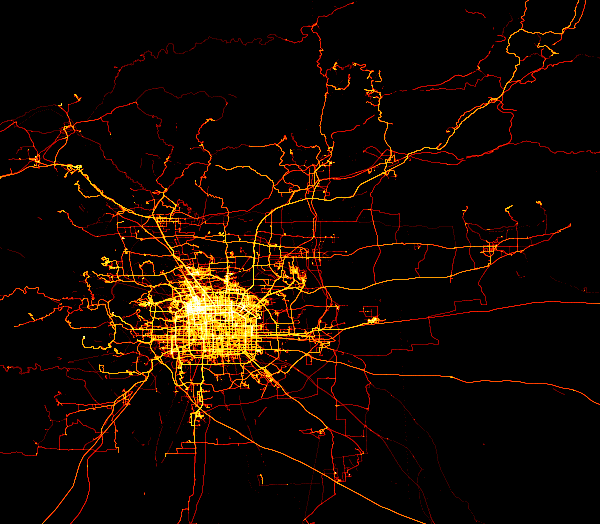
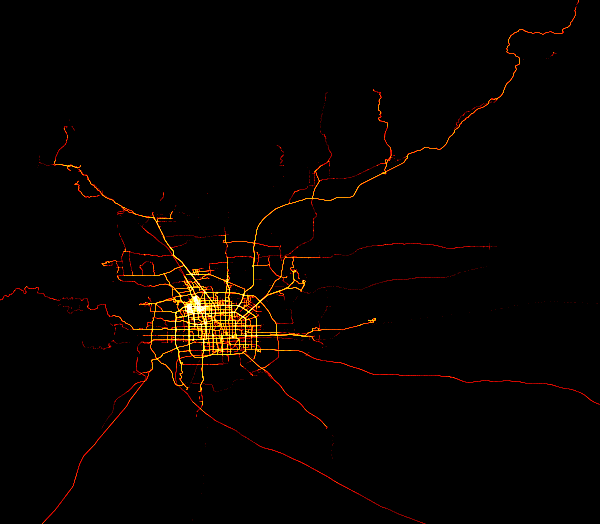
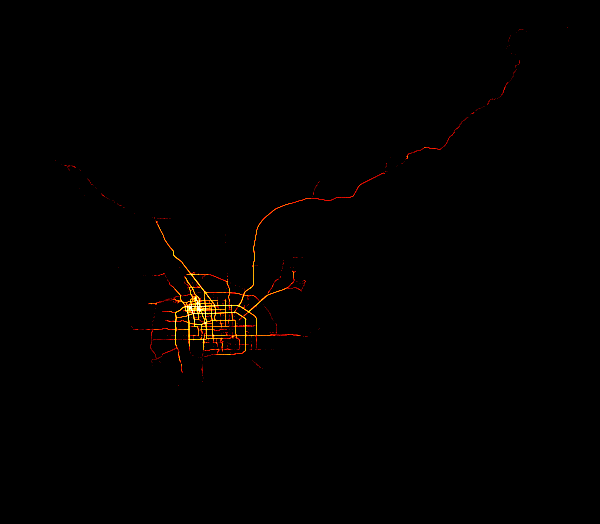
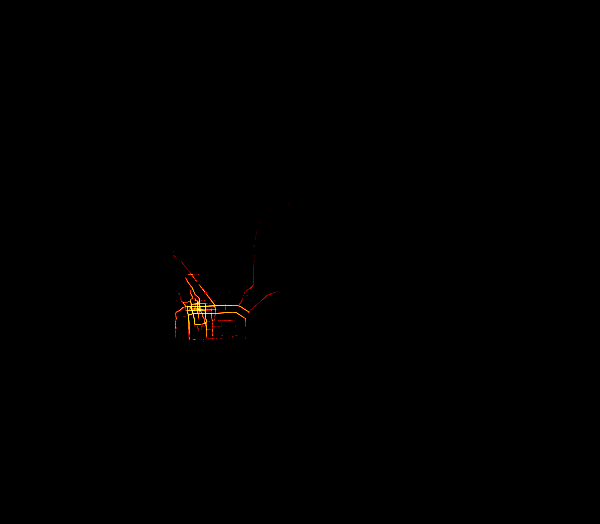

In [36]:
#plotting on canvases
tf.Images(plotDFBeijingWithDS(df,600, 524), plotDFBeijingWithDS(matDF3,600, 524),plotDFBeijingWithDS(matDF2,600, 524), plotDFBeijingWithDS(matDF1,600, 524))

<a id='012'></a>
## Influence Analysis
In this section we look at the relation between the influence of an individual and the k factor.
<a id='013'></a>
### Hamming Distance and Influence

We will first start by introducing the hamming distance between two matrices. In our case, the hamming distance between two binary matrices of same dimensions is the number of bit positions in which the two bits are different. Later, we use the hamming distance to play with the idea of the influence of an individual. 

<h4><center>Example:</center></h4>

We calculate the hamming distance between the two given matrices below.

$$\begin{bmatrix} 1 & 0 & 0 & 1 & 0 & 1 \\ 0 & 1 & 0 & 1 & 1 & 0 \\ 0 & 0 & 1 & 0 & 1 & 0 \\ 1 & 0 & 0 & 0 & 1 & 0 \end{bmatrix} \begin{bmatrix} 0 & 0 & 1 & 1 & 0 & 0 \\ 0 & 0 & 0 & 1 & 0 & 0 \\ 0 & 0 & 0 & 1 & 1 & 0 \\ 0 & 0 & 0 & 0 & 1 & 1 \end{bmatrix} $$

The indices [i,j] are the same as matrix[i][j]. For example, the left matrix at indices [0,0] is equal to 1 while the right matrix at indice [0,0] is equal to 0. To get the hamming distance, we need to consider any point where the leftMatrix[i][j]!=rightMatrix[i][j]. The matrices are different at indices [0,0], [0,2], [0,5], [1,1], [1,4], [2,2], [2,3], [3,0] and [3,5]. This is a total of 9 places, thus the hamming distance is equal to 9.

The function `hammingDistance` gets the hamming distance between two matrices. When it the `forHotspot` input(a boolean) is True, we will assume the matrices are hotspots and the function will work in a certain. For exampke, if the input "hotspot1" is the hotspot from *n* individuals, the input "hotspot2" needs to be the hotspot from the same *n* individuals plus any other individual(s). However, if `forHotspot` is false it will caclulate the hamming distance the "traditional way".

In [37]:
def hammingDistance(hotspot1, hotspot2, forHotspot):
    if forHotspot:
        arr1 = np.nonzero(hotspot1)
        arr2 = np.nonzero(hotspot2)
        return abs(len(arr1[0])- len(arr2[0]))
    else: 
        hdist = 0
        for i in range(len(hotspot1)):
            for j in range(len(hotspot1[1])):
                if hotspot1[i][j]!=hotspot2[i][j]:
                    hdist+=1
    return hdist

   The function `kToInfluenceCorelation` returns a list of coordinates [k, influece]. It takes as input a list of individuals and an individual whose 'influence' will be measured as k rises. The influence is measured as the hamming distance between two hotspots, one with all the individuals but the individual who is being compared and the other with all the individuals. By looking at the hamming distance between those two hotspots, we are able to understand how much the individual in question is influencing the common matrix as k is changed. 
   <br>

Using the function `hammingDistance`, we repeat the process while increasing k by one, hoping to create a relation between k and 'influence'. Later, we use the matplotlib library to graph these points and perform a few regressions as well as calculate $r^2$.

In [1]:
def kToInfluenceCorelation(IndividualsToCompareWith, IndividualCompared, hotspotWidthHeight):
    f1mat = getFinalMatrix(allDF, mat, hotspotWidthHeight, IndividualsToCompareWith)
    f2mat = f1mat+getFinalMatrix(allDF, mat, hotspotWidthHeight, IndividualCompared)
    X_Y = []
    print("Loading ...")
    for k in range(1,181):
        hotspot1 = hotspotFunction(f1mat, k)
        hotspot2 = hotspotFunction(f2mat, k)
        influence = hammingDistance(hotspot1, hotspot2, True)
        X_Y.append([k, influence])
        clear_output(wait=True)
        if influence==0:
            break
    clear_output()
    return X_Y

In [ ]:
#Using kToInfluenceCorelation, we get the *k* to *influence* corralation between the indviduals 10 and [0,1,2,3] and we will  
#graph them later using matplotlib.
xAndY = kToInfluenceCorelation([20], [0,1,2,3], 10)

<a id='014'></a>
### Graphing the Influence vs. K

Once we have created a set of points using the `kToInfluenceCorelation` function, we want to graph them. Before writting the graphing function, we write a few other important functions.

The function `fit_exp` takes a list of x and a list of y then makes a best fit exponential function. Following the basic format of an exponential function, $y=a*e^{b*x}$, the function returns both 'a' and 'b' and later we use this function to do an exponential regression and plot it.

In [264]:
def fit_exp(xs, ys):
    S_x2_y = 0.0
    S_y_lny = 0.0
    S_x_y = 0.0
    S_x_y_lny = 0.0
    S_y = 0.0
    for (x,y) in zip(xs, ys):
        S_x2_y += x * x * y
        S_y_lny += y * np.log(y)
        S_x_y += x * y
        S_x_y_lny += x * y * np.log(y)
        S_y += y
    a = (S_x2_y * S_y_lny - S_x_y * S_x_y_lny) / (S_y * S_x2_y - S_x_y * S_x_y)
    b = (S_y * S_x_y_lny - S_x_y * S_y_lny) / (S_y * S_x2_y - S_x_y * S_x_y)
    return (np.exp(a), b)

The following function was made in order to do the $R^2$ test for an exponential function following the formal $y=A*e^{bx}$. The inputs are $A$, $b$, the Xs and the Ys. Note that if $R^2 < 0$, that means that the exponential fit is worse than fiting a horizontal line. While we can use *numpy* to make a $R^2$ test on a linear regression, numpy can not do it for an exponential fit.

In [265]:
def rSquaredForExp(A, B, xs, ys):
    expected = []
    mean_y = 0
    counter = 0
    l = len(xs)
    for i in range(l):
        if ys[i]>0:
            expected.append(A*np.exp((B*xs[i])))
            counter+=1
            mean_y+=ys[i]
    mean_y/=counter
    SSR = 0
    SST = 0
    l = len(expected)
    for i in range(l):
        SSR+= (expected[i]-ys[i])**2
        SST+=(mean_y-ys[i])**2
    return 1-(SSR/SST)

In [3]:
#We import matplotlib in order to graph the points and do more
import matplotlib.pyplot as plt

The next function takes a list of (x,y) coordinates and plots two graphs: one with a scatter plot and a best fit line and the second one also with a scatter plot but wih an exponential best fit. The `plotData` function uses matplotlib and numpy as well as the two functions created above.

In [68]:
def plotData(data):
    k = []
    influence = []
    for i in data:
        if i[1]>0:
            k.append(i[0])
            influence.append(i[1])
    plt.figure()
    #The few following lines allow us to do the R^2 test for the linear regression
    mat_corr = np.corrcoef(k, influence)
    corr_yx = mat_corr[0,1]
    r_2 = round(corr_yx**2, 3)
    plt.scatter(k, influence)
    m, b = np.polyfit(k, influence, 1)
    x = np.linspace(min(k), max(k), 10)
    y = m*x+b
    label = "Equation: y = "+ str(round(m, 3))+"x + "+str(round(b, 2))+"             R^2="+str(r_2)
    plt.plot(x, y, label = label)
    plt.xlabel("K")
    plt.ylabel("Influence Of Individual")
    plt.title('Line Best Fit')
    plt.legend()
    plt.show()
    plt.figure()
    plt.scatter(k, influence)
    (A, B) = fit_exp(k, influence)
    x = np.linspace(min(k), max(k), 50)
    y = A * np.exp(B *x)
    #the few following lines allow us to do the R^2 test for the exponential regression
    R_squaredExp = rSquaredForExp(A, B, k, influence)
    label2 = "Equation: y = "+str(round(A, 3))+"e^"+ str(round(B,2))+"x             R^2="+str(round(R_squaredExp,3))
    plt.plot(x,y, label=label2)
    plt.title('Exponential Best Fit')
    plt.xlabel('K')
    plt.ylabel('Influence Of Individual')
    plt.legend()
    plt.show()

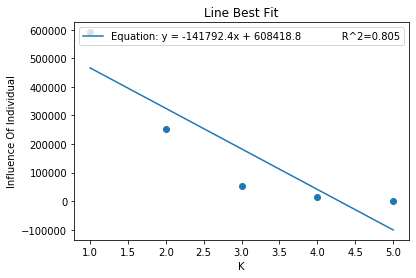

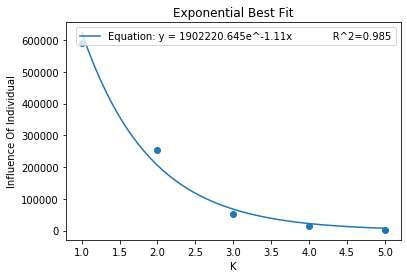

In [271]:
#Graphing the kToInfluenceCorelation we created 
plotData(xAndY)

We then ran the same operations, but comparing all the individuals to individual `153`. The code looked something like this:
```python
xAndY = kToInfluenceCorelation([153],[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181], 30)
```
Running this piece of code took \_\_\_\_\_ time. And then when we ran:
```python 
plotData(xAndY)
```
To get:

<img src="img/GraphDrawing.png" width="400">

<a id='015'></a>

## Differential Privacy

Now that we have explored the influence of individuals on the dataset and have done some influence analysis, we want to shift our focus to randomness and differential privacy. First, we import the `random` library in order to have a way to use randomness in our code. 

### Loading the data and running the random function
<a id='016'></a>

In [17]:
import random

The next function will take the dfBeijing dataframe, a dataframe with all the points that were within the Beijing limits, and for every places someone was, a 0-value was turned into a 1. This function is similar to the function `getFinalMatrix` when run on all the individuals, except the function below loads the data into a 01 matrix with no values exceeding 1 while `getFinalMatrix` loaded the data into a nonbinary matrix with values ranging from 0 to 10 and even higher.

In [27]:
def loadInto01Mat(dfBeijing, mat):
    for x,y in zip(dfBeijing['X'], dfBeijing['Y']):
        i = math.floor((x-mat[0][1])/mat[0][4])
        j = math.floor((mat[0][2]-y)/mat[0][4])
        mat[1][j][i] = 1
    return mat

In [28]:
#Loading the 01 matric of the Beijing area into the matrix mat
mat = loadInto01Mat(dfBeijing, mat)

The function `probabilityChanging` is the "random" function which runs for every square in the matrix created above and with a probability l will change the value of the matrix cell to a 0 with 50% chance and 1 with 50% chance. I describe the process with an example below. The inputs are mat, a 01 matrix, and l, the probability of lying in the range of [0,1]. 

Let's say we start with the following matrix : $$\begin{bmatrix} 0 & 0 & 1 & 1 & 0 & 0 \\ 0 & 0 & 0 & 1 & 0 & 0 \\ 0 & 0 & 0 & 1 & 1 & 0 \\ 0 & 0 & 0 & 0 & 1 & 1 \end{bmatrix}$$
The function will go through the first value, 0, and get a random number, x, between 0 and 1. If x < l, that means that we will "lie" or that we will changed the value of the table and if x > l, then the value of the matrix, in this case 0, will be left as it is. In the case where we "lie", we generate a random number between 0 and 1 with a 50% probability for each and replace the matrix's value, in this case 0, with the generated number. For example, let's say that our input l=0.33 and we get x=0.123, then we will lie. After running the `random.randrange(0,2)`, we get 1, so we replace the 0 with a 1. The process is repeated for each cell in the matrix.
   
The edited matrix after the example:
$$\begin{bmatrix} 1 & . & . & . & . & . \\ . & . & . & . & . & . \\ . & . & . & . & . & . \\ . & . & . & . & . & . \end{bmatrix}$$ 

In [29]:
def probabilityChanging(mat, l):
    cmat = np.copy(mat)
    h = len(mat)
    w = len(mat[1])
    for i in range(h):
        for j in range(w):
            if random.random()<l:
                cmat[i][j]=random.randrange(0,2)
    return cmat

The function below takes 3 matrices, changes their format to dataframes and graph them. We use them to show how `probabilityChanging` function changes the dataset at different probability of lying l. This function uses 2 functions created previously in the code, `getDFfromMat`, to switch matrix to dataframes, and `plotDFBeijingWithDS`, to draw the dataframes using datashader.  

In [30]:
def draw3EditedMatrices(mat1, mat2, mat3):
    df1 = getDFfromMat(12890797, 4982886, 10, mat1)
    df2 = getDFfromMat(12890797, 4982886, 10, mat2)
    df3 = getDFfromMat(12890797, 4982886, 10, mat3)
    return tf.Images(plotDFBeijingWithDS(df1,600, 524),plotDFBeijingWithDS(df2,600, 524), plotDFBeijingWithDS(df3,600, 524))

In the next 3 cells, I used the function above to draw nine matrices after having gone through `probabilityChanging` functions with l being 0, 0.001,1.002, 0.003, 0.05, 0.1, 0.5, 0.75 and 1. Running the cells can take a couple minutes, and the images generated are below the three coding cells.

In [31]:
mat1 = mat[1]
mat2 = probabilityChanging(mat[1], 0.001)
mat3 = probabilityChanging(mat[1], 0.002)
draw3EditedMatrices(mat1, mat2, mat3)

NameError: name 'probabilityChanging' is not defined

,,

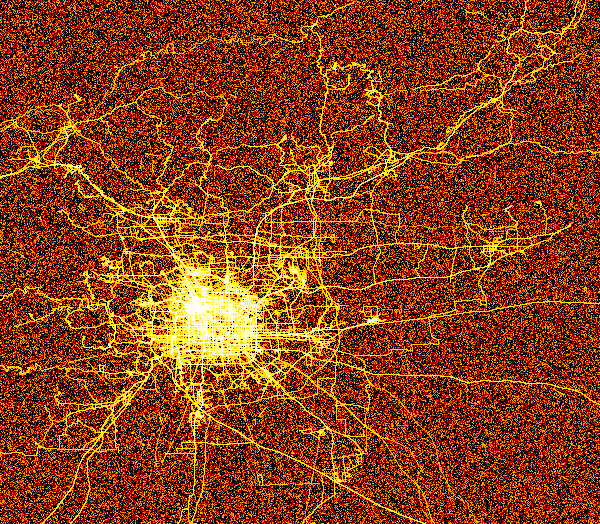
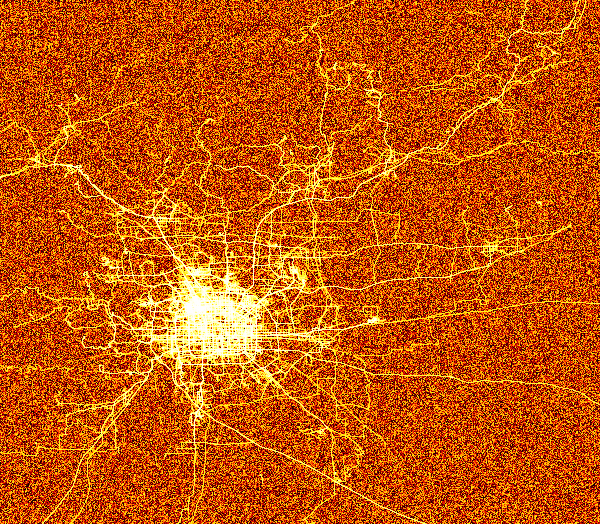
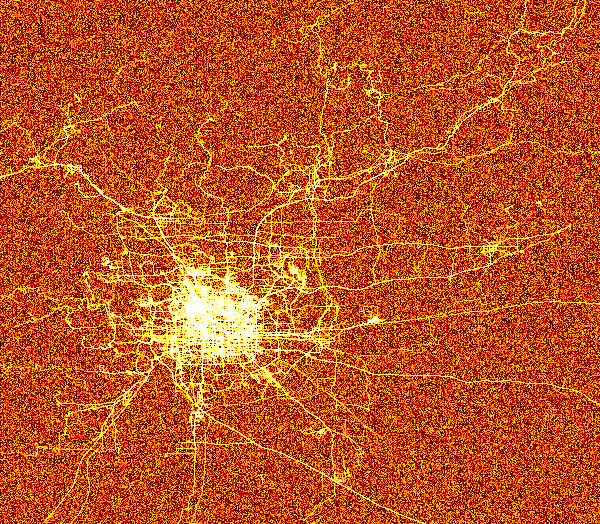

In [96]:
mat1 = probabilityChanging(mat[1], 0.003)
mat2 = probabilityChanging(mat[1], 0.05)
mat3 = probabilityChanging(mat[1], 0.1)
draw3EditedMatrices(mat1, mat2, mat3)

,,

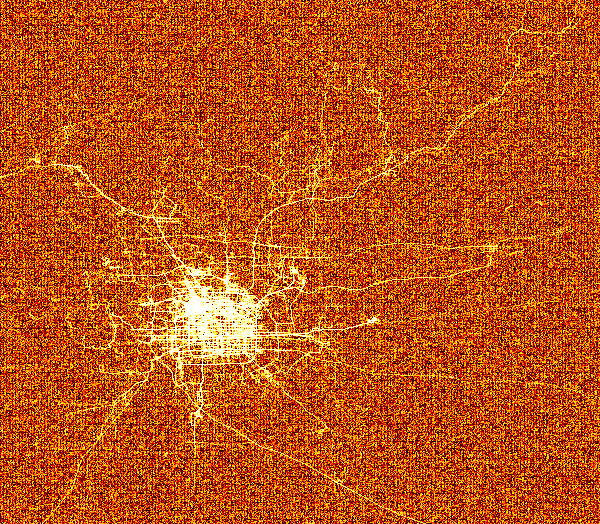
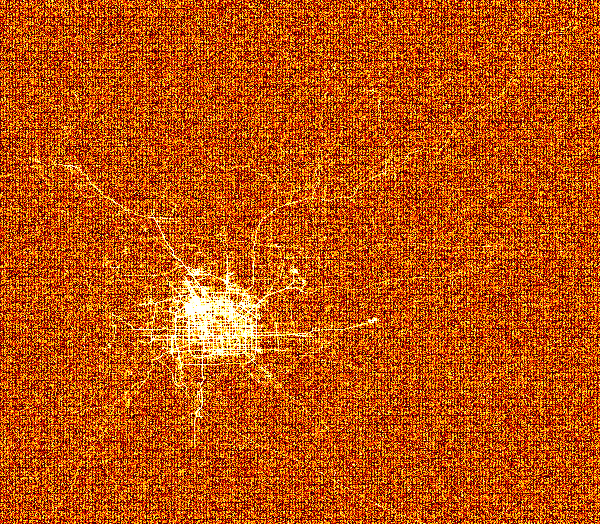
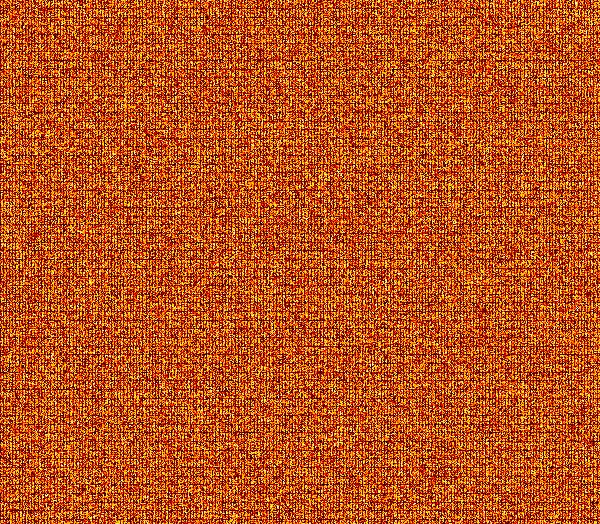

In [89]:
mat1 = probabilityChanging(mat[1], 0.5)
mat2 = probabilityChanging(mat[1], 0.75)
mat3 = probabilityChanging(mat[1], 1)
draw3EditedMatrices(mat1, mat2, mat3)

Finally, if you couldn't see the images generated above then we have them below. The images generated were as followed, from the lowest lying probablity on the top left corner to the highest on the lower right corner. We can see that the noise generated was largest as l increased as the images became more and more static.

<img src="img/lowls.png" width="700">
<img src="img/midls.png" width="700">
<img src="img/highls.png" width="700">

[Back to top](#000-2)

# /////////////////////////////////////////////////////////////////////////////////////////////////////////////////////////////////////

This portion of the code has yet to be documented

In [35]:
#where n is the number of "experiments", l is the probability of lying and mat is the 1 and 0 matri create with the first 
#of the section
def experimentWithDifferetialPrivacy(n, l, mat):
    foutput = []
    for cw in range(n):
        mat1 = probabilityChanging(mat[1], l)
        mat2 = probabilityChanging(mat[1], l)
        foutput.append(hammingDistance(mat1, mat2, False))
        clear_output(wait=True)
        print(round((cw+1/n)*100,1),"%",flush=True)
    clear_output()
    return foutput

In [ ]:
l = experimentWithDifferetialPrivacy(100, 0.01, mat)

1.0 %


In [11]:
def average(l):
    return sum(l)/len(l)

In [12]:
def variance(l):
    xbar = average(l)
    t = 0
    for i in l:
        t+=(i-xbar)**2
    return (t)/(len(l)-1)

In [13]:
def standardDeviation(l):
    return pow(variance(1), 1/2)

In [13]:
#Runs the experimentWithDifferentialPrivacy for multiple l where we record the average and the variance of an individual "experiment"
def differentialPrivateDataForDifferentl(lgap, n, mat):
    l = lgap
    output = [[0,0]]
    while(lgape<=1):
        data = experimentWithDifferetialPrivacy(n, l, mat)
        output.append([l, average(data), variance(data),n])
        l+=lgap
    return output

In [14]:
#following function creates a distribution of the data l with a histogram.
def graphDistribution(l):
    plt.figure()
    plt.title("Histogram of Experiment's Data")
    plt.xlabel('Hamming Distance')
    plt.ylabel('Frequency')
    label1 = "Mean : "+ str(round(average(l), 4))+"                                   Variance = : " + str(round(variance(l),4))
    plt.hist(l, bins=100, label = label1)
    plt.legend()
    plt.show()

In [33]:
#This would graph the hamming distances at different ls 
def graphingWithErrorBars(l):
    plt.figure()
    plt.title("The average and variance of the hamming distance at the probability of lying l")
    plt.xlabel('Probability of lying (l)')
    plt.ylabel('Hamming Distance')
    x = []
    y = []
    err = []
    for i in l:    
        x.append(i[0])
        y.append(i[1])
        err.append(pow(i[2], 1/2)/(pow(i[3],1/2)))
    plt.errorbar(x, y, yerr=err, label='Error Bars',fmt='o')
    plt.legend()
    plt.show()

# For next time:
- Get the code running well on sagemaker(sharing and making sure there are no problems)

 
 #### Functions to make
-  make a function that goes through each user, adds the neighbor litted points, generate a noisy version of his data, with the lying skeme. Run it for all 182 individuals and add the matrices and run k-hotspot function with large k. Generate images of table with different l, starting from 0 and 1, and different ks.
 
- pick a particular user and see how his data behaves with different ls, showig that the data is being killed, but less than the entire data